# The Beating Heart of Art

VGG16 + Nearest Neighbors

In [121]:
# for loading/processing the images  
from tensorflow.keras.preprocessing.image import load_img 
from tensorflow.keras.preprocessing.image import img_to_array 
from tensorflow.keras.applications.vgg16 import preprocess_input 
# models 
from tensorflow.keras.applications.vgg16 import VGG16 
from tensorflow.keras.models import Model
# neighbors and dimension reduction
from sklearn.neighbors import NearestNeighbors
from sklearn.decomposition import PCA
# for everything else
import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd
import pickle

In [122]:
os.chdir('/Volumes/JEGUE') # path where the "data" folder is located
!pwd

/Volumes/JEGUE


In [124]:
def image_files(path):
    '''
    
    Creates a list with the names of all image files.
    path: the path to the directory where the images are stored.
    
    '''
    image_files = []
    # creates a ScandirIterator aliased as files
    with os.scandir(path) as files:
      # loops through each file in the directory
        for file in files:
            if file.name.endswith('.jpg'):
              # adds only the image files to the flowers list
                image_files.append(f'{path}/{file.name}')
    return image_files

In [125]:
image_files = image_files('images')

In [127]:
len(image_files)

4214

In [128]:
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

In [129]:
def extract_features(file, model):
    '''
    Extract features of an image file using the VGG16 model.
    '''
    # load the image as a 224x224 array
    img = load_img(file, target_size=(224,224))
    # convert from 'PIL.Image.Image' to numpy array
    img = np.array(img) 
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3) 
    # prepare image for model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)

    return features

In [130]:
def all_features(image_files, model):
    data = {}
    for image in image_files:
    # try to extract the features and update the dictionary
        feat = extract_features(image, model)
        image = image.split('/')[-1]
        data[image] = feat
    return data

In [131]:
data = all_features(image_files, model)

1/1 [==============================] - 0s 342ms/step


1/1 [==============================] - 0s 347ms/step


1/1 [==============================] - 0s 451ms/step


1/1 [==============================] - 0s 337ms/step


1/1 [==============================] - 0s 344ms/step


1/1 [==============================] - 0s 392ms/step


1/1 [==============================] - 0s 339ms/step


1/1 [==============================] - 0s 350ms/step


1/1 [==============================] - 0s 349ms/step


1/1 [==============================] - 0s 345ms/step


1/1 [==============================] - 0s 346ms/step


1/1 [==============================] - 0s 394ms/step


1/1 [==============================] - 0s 340ms/step


1/1 [==============================] - 0s 358ms/step


1/1 [==============================] - 0s 363ms/step


1/1 [==============================] - 0s 371ms/step


1/1 [==============================] - 0s 371ms/step


1/1 [==============================] - 1s 617ms/step


1/1 [==============================] - 0s 344ms/step


1/1 [==============================] - 0s 364ms/step


1/1 [==============================] - 0s 366ms/step


1/1 [==============================] - 0s 459ms/step


1/1 [==============================] - 0s 439ms/step


1/1 [==============================] - 0s 398ms/step


1/1 [==============================] - 0s 375ms/step


1/1 [==============================] - 1s 539ms/step


1/1 [==============================] - 0s 432ms/step


1/1 [==============================] - 0s 397ms/step


In [132]:
# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))

# reshape so that there are 210 samples of 4096 vectors
feat = feat.reshape(-1,4096)

In [161]:
with open("/Users/eric/code/Goli-SF/notebooks/filenames.pkl", "wb") as file:
    pickle.dump(filenames, file)

In [133]:
pca = PCA(n_components=100, random_state=22)
pca.fit(feat)
X = pca.transform(feat)

In [160]:
with open("/Users/eric/code/Goli-SF/notebooks/pca.pkl", "wb") as file:
    pickle.dump(pca, file)

In [134]:
def find_neighbors(X, target, n_neighbors=4):
    neigh = NearestNeighbors(n_neighbors=n_neighbors)
    neigh.fit(X)
    kneighbors = neigh.kneighbors(target.reshape(1,-1))[1].tolist()[0]
    return kneighbors

In [156]:
def plot_neighbors(neighbors):
    plt.figure(figsize = (50,50));
    for index, file in enumerate(neighbors):
        plt.subplot(1,len(neighbors),index+1);
        img = load_img(f'images/{filenames[file]}')
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')
        #if index == 0:
         #   plt.title('Input image', {'fontsize': 50, 'color': 'red'})

[0, 4034, 4064, 3923]
[1, 3344, 929, 3343]
[2, 10, 4207, 4211]
[3, 2918, 832, 4206]
[4, 4062, 4067, 4055]
[648, 5, 1742, 1707]
[6, 605, 1614, 1613]
[7, 559, 834, 868]
[8, 4207, 10, 2]
[9, 4044, 4067, 541]
[10, 2, 4207, 8]
[11, 814, 1804, 808]
[12, 1959, 1994, 639]
[13, 1537, 1544, 1543]
[14, 4207, 3339, 4211]
[15, 936, 102, 951]
[16, 525, 617, 1080]
[17, 2159, 595, 2324]
[18, 77, 637, 1157]
[19, 21, 767, 184]


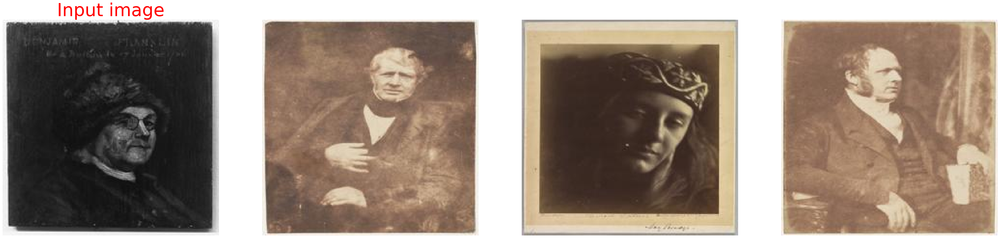

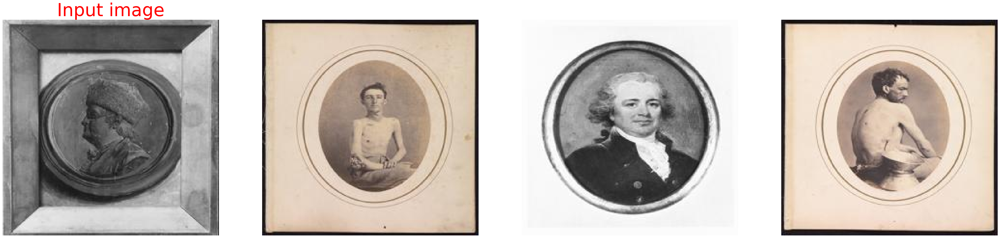

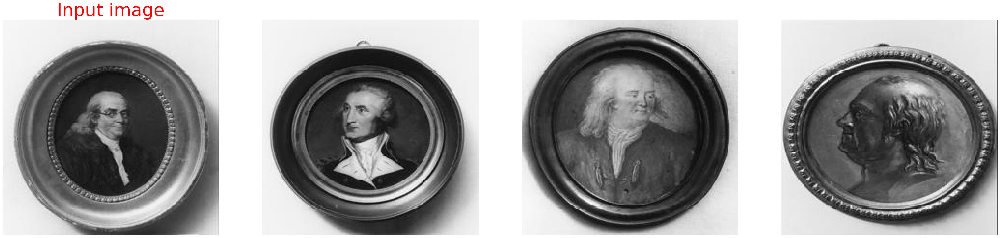

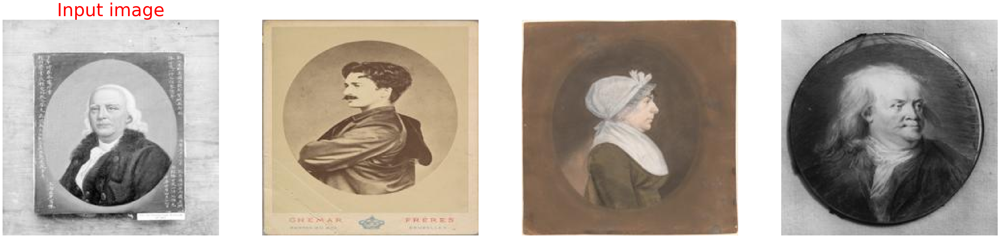

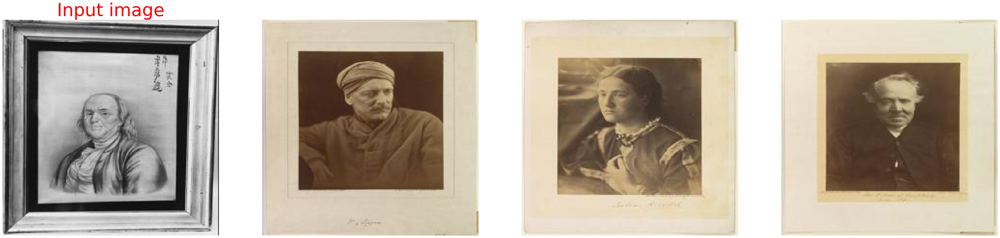

...

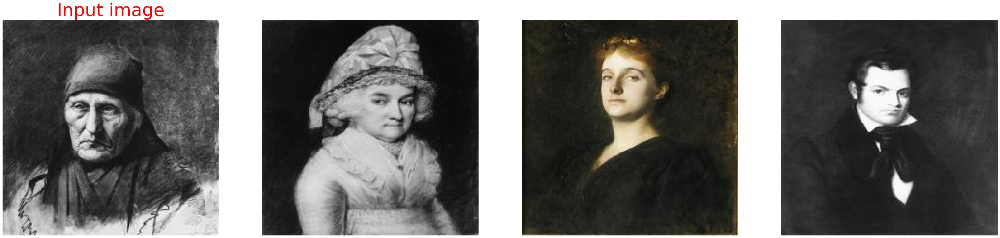

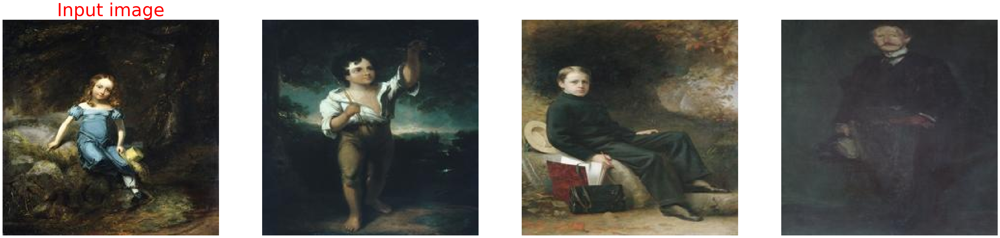

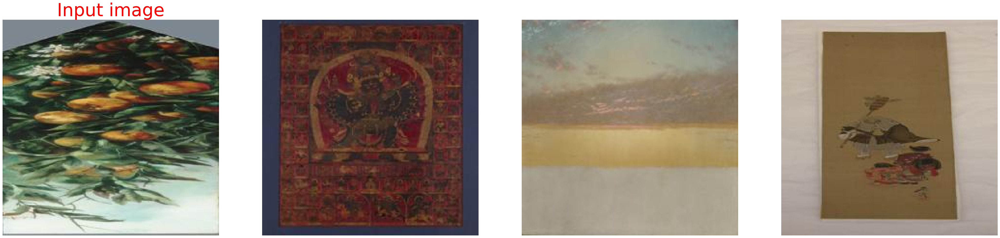

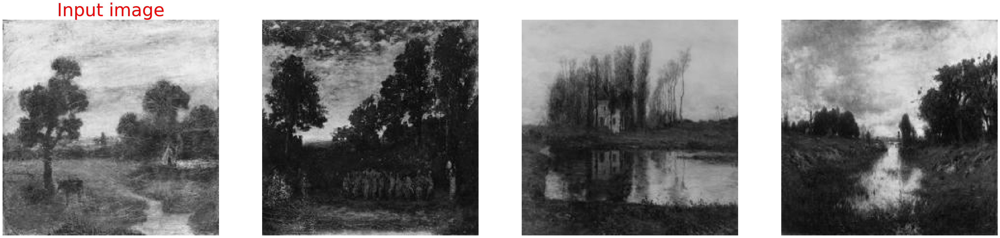

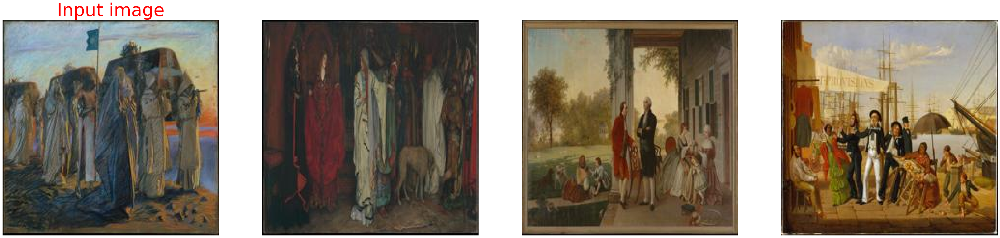

In [143]:
for x in range(20):
    neighbors = find_neighbors(X, X[x])
    print(neighbors)
    plot_neighbors(neighbors)

[20, 1291, 1640, 4056]
[21, 555, 1078, 767]
[22, 48, 632, 4045]
[23, 632, 643, 48]
[24, 1055, 1164, 2418]
[25, 309, 407, 2056]
[26, 3380, 1041, 1217]
[27, 2023, 2522, 3957]
[28, 695, 886, 696]
[29, 235, 870, 297]
[30, 876, 2054, 354]
[31, 380, 340, 539]
[32, 571, 909, 617]
[33, 2415, 2370, 925]
[34, 391, 390, 389]
[35, 340, 1031, 989]
[36, 693, 677, 947]
[37, 298, 680, 1217]
[38, 458, 385, 1014]
[39, 684, 56, 2021]


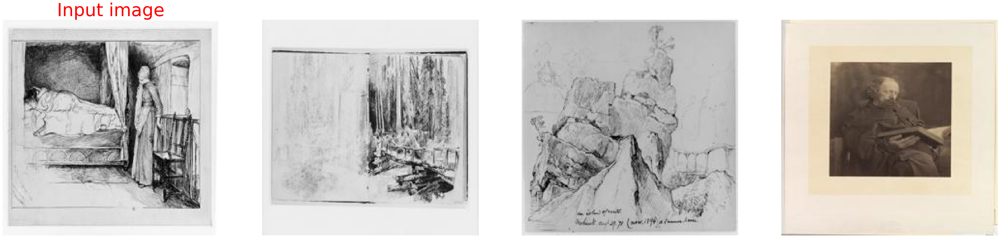

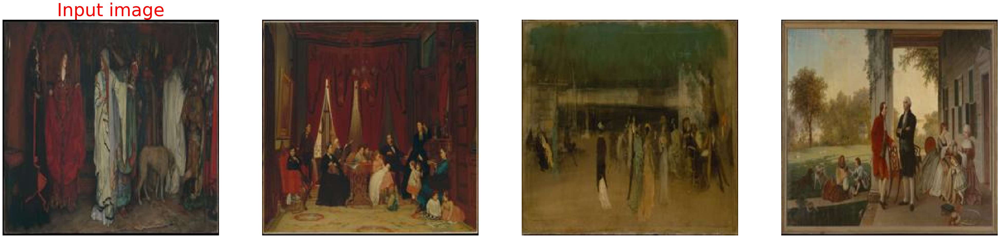

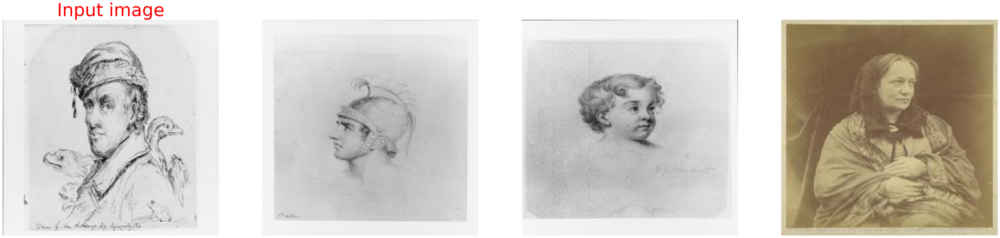

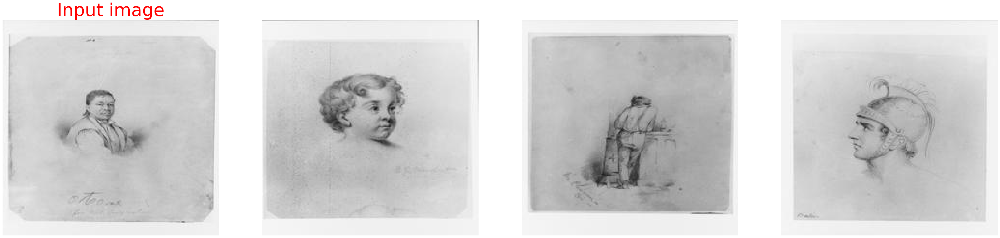

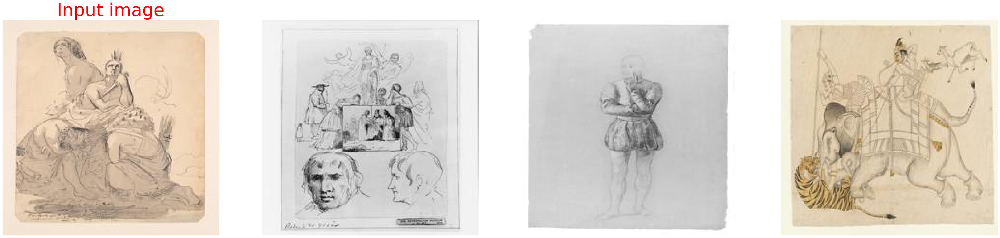

...

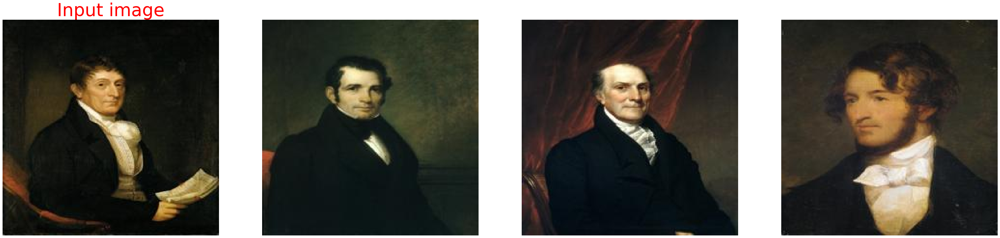

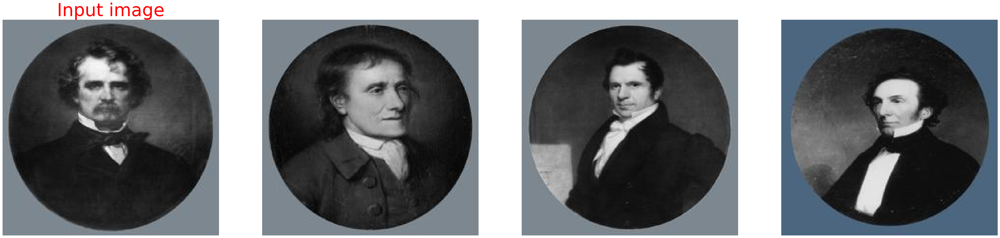

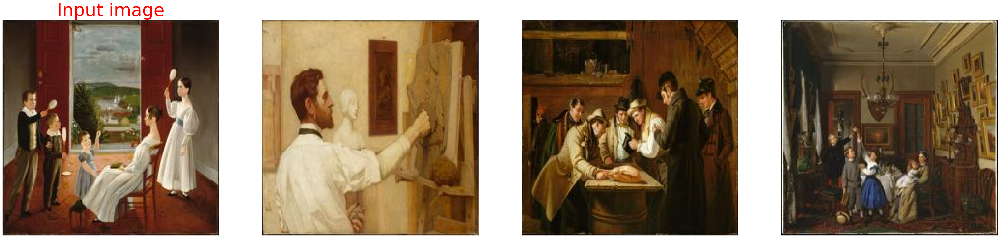

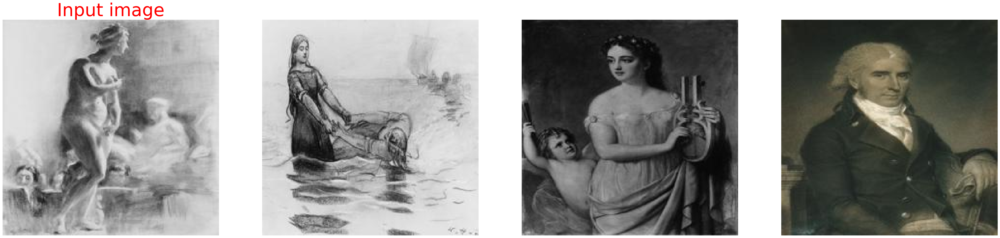

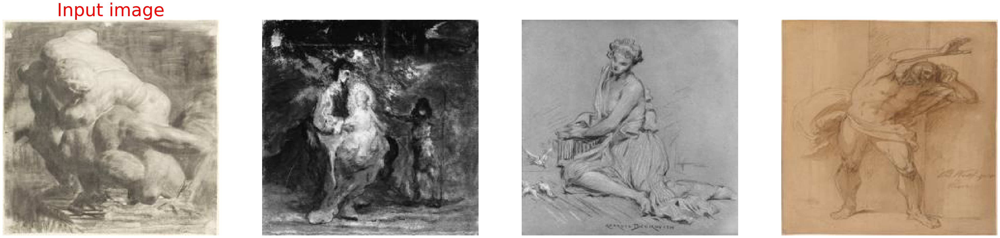

In [144]:
for x in range(20,40):
    neighbors = find_neighbors(X, X[x])
    print(neighbors)
    plot_neighbors(neighbors)

## Testing with an input image

In [148]:
input_features = extract_features('expressionismo_3.jpg', model)

1/1 [==============================] - 0s 364ms/step


In [151]:
input_features = pca.transform(input_features)

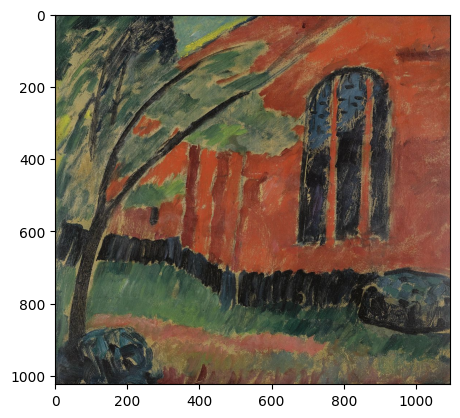

In [155]:
img = load_img('expressionismo_3.jpg')
plt.imshow(img)

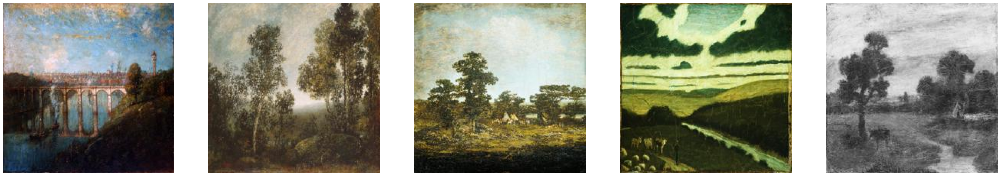

In [157]:
neighbors = find_neighbors(X, input_features, 5)
plot_neighbors(neighbors)

In [159]:
with open("/Users/eric/code/Goli-SF/notebooks/features.pkl", "wb") as file:
    pickle.dump(X, file)

In [162]:
!pwd

/Volumes/JEGUE
